In [ ]:
#  Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')




Mounted at /content/drive


In [ ]:
!pip install gymnasium

In [ ]:
import argparse
import gymnasium as gym
import numpy as np
from itertools import count
from collections import deque
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.distributions import Categorical

# Hyperparameters
gamma = 0.99          # Discount factor for future rewards
seed = 543            # Random seed for reproducibility
log_interval = 10     # Interval for logging during training

# Create the environment (CartPole-v1)
env = gym.make('CartPole-v1')
env.reset(seed=seed)  # Reset the environment with a fixed seed

# Lists to track scores and losses during training
scores, running_scores = [], []
losses = []

# Define the policy network as a neural network model
class Policy(nn.Module):
    def __init__(self):
        super(Policy, self).__init__()
        # First affine layer (Linear) with 4 input features, 128 output features
        self.affine1 = nn.Linear(4, 128)
        # Dropout layer for regularization with 60% dropout rate
        self.dropout = nn.Dropout(p=0.6)
        # Second affine layer with 128 input features, 2 output features (for 2 actions)
        self.affine2 = nn.Linear(128, 2)

        # Lists to store the log probabilities and rewards for policy updates
        self.saved_log_probs = []
        self.rewards = []

    def forward(self, x):
        # Forward pass through the neural network layers
        x = self.affine1(x)
        x = self.dropout(x)    # Apply dropout for regularization
        x = F.relu(x)          # ReLU activation
        action_scores = self.affine2(x)  # Output action scores (logits)
        return F.softmax(action_scores, dim=1)  # Softmax to get action probabilities


# Initialize the policy network and optimizer
policy = Policy()
optimizer = optim.Adam(policy.parameters(), lr=1e-2)
eps = np.finfo(np.float32).eps.item()  # Small value to avoid numerical instability

# Function to select an action based on the current state
def select_action(state):
    state = torch.from_numpy(state).float().unsqueeze(0)  # Convert state to tensor
    print(f'state is {state}')  # Print the state
    probs = policy(state)  # Get the action probabilities from the policy network
    print(f'probs = {probs}')  # Print the action probabilities
    m = Categorical(probs)  # Create a categorical distribution from the probabilities
    print(f'm or dist is {m}')  # Print the distribution
    action = m.sample()  # Sample an action from the distribution
    print(f'sampled action is {action}')  # Print the sampled action
    policy.saved_log_probs.append(m.log_prob(action))  # Save the log probability of the action
    print(f'log prob of the sampled action {m.log_prob(action)}')  # Print log probability
    return action.item()  # Return the action as an integer

# Function to finish an episode and update the policy
def finish_episode():
    R = 0
    policy_loss = []  # List to store the individual losses
    returns = deque()  # Deque to store the returns for each time step

    # Compute the returns (discounted sum of rewards) from the end of the episode
    for r in policy.rewards[::-1]:
        R = r + gamma * R  # Compute the discounted return
        returns.appendleft(R)  # Append it to the front of the deque
        print(f'R = {R}')  # Print the return

    returns = torch.tensor(returns)  # Convert the returns to a tensor
    returns = (returns - returns.mean()) / (returns.std() + eps)  # Normalize the returns
    print(f'returns 4 elements normalized {returns[:4]}')  # Print the first few normalized returns

    # Compute the policy loss (negative log probability * return)
    for log_prob, R in zip(policy.saved_log_probs, returns):
        policy_loss.append(-log_prob * R)  # Append the loss for each time step
        losses.append(policy_loss)  # Append to the list of losses
        print(f'policy loss is {policy_loss}')  # Print the policy loss

    # Perform backpropagation and update the policy network
    optimizer.zero_grad()  # Zero the gradients
    policy_loss = torch.cat(policy_loss).sum()  # Sum the policy losses
    print(f'summed policy loss is {policy_loss}')  # Print the total loss
    policy_loss.backward()  # Backpropagate the loss
    optimizer.step()  # Update the network parameters
    del policy.rewards[:]  # Clear the rewards list
    del policy.saved_log_probs[:]  # Clear the saved log probabilities
    print(f'now log probs and rewards are deleted')  # Print when the lists are cleared

    return losses  # Return the list of losses

# Main function to train the policy
def main():
    folder_path = '/content/drive/MyDrive/Models/folder_path/'

    # File names for saving results
    scores_file = f'scores_2nd_example.npy'
    running_scores_file = f'running-scores_2nd_example.npy'
    loss_file = f'losses_2nd_example.npy'

    running_reward = 10  # Initialize running reward for tracking performance

    # Training loop (episodes)
    for i_episode in count(1):
        state = env.reset()[0]  # Reset the environment and get the initial state
        ep_reward = 0  # Initialize the episode reward

        # Loop through time steps within each episode
        for t in range(1, 10000):  # Avoid infinite loop, limit the number of time steps
            action = select_action(state)  # Select an action based on the current state
            print(f'given action to env (not item) {action}')  # Print the action
            state, reward, done, _, _ = env.step(action)  # Step through the environment with the selected action
            print(f'reward being saved {reward} next state {state} done {done}')  # Print the reward, state, and done flag

            policy.rewards.append(reward)  # Store the reward for policy update
            ep_reward += reward  # Accumulate the total episode reward
            if done:
                break  # Exit the loop if the episode is done

        # Store the episode score and update the running reward
        scores.append(ep_reward)
        running_reward = 0.05 * ep_reward + (1 - 0.05) * running_reward
        running_scores.append(running_reward)
        print(f'running reard {running_reward}')  # Print the running reward

        losses = finish_episode()  # Finish the episode and update the policy

        # Log the results every log_interval episodes
        if i_episode % log_interval == 0:
            print('Episode {}\tLast reward: {:.2f}\tAverage reward: {:.2f}'.format(
                  i_episode, ep_reward, running_reward))

        # Check if the policy has solved the environment
        if running_reward > env.spec.reward_threshold:
            print("Solved! Running reward is now {} and "
                  "the last episode runs to {} time steps!".format(running_reward, t))
            # Save the training results (scores, running scores, and losses)
            np.save(f'{folder_path}{scores_file}', scores)
            np.save(f'{folder_path}{running_scores_file}', running_scores)
            losses = [l.detach().cpu().numpy() if isinstance(l, torch.Tensor) else l for l in losses]
            np.save(f'{folder_path}{loss_file}', losses)
            return losses  # Return the losses if the environment is solved

# Entry point of the program
if __name__ == '__main__':
    losses = []
    losses = main()  # Run the main function to train the policy


Streaming output truncated to the last 5000 lines.
probs = tensor([[0.7422, 0.2578]], grad_fn=<SoftmaxBackward0>)
m or dist is Categorical(probs: torch.Size([1, 2]))
sampled action is tensor([1])
log prob of the sampled action tensor([-1.3555], grad_fn=<SqueezeBackward1>)
given action to env (not item) 1
reward being saved 1.0 next state [-0.9606327   0.02854698  0.02615271 -0.51967585] done False
state is tensor([[-0.9606,  0.0285,  0.0262, -0.5197]])
probs = tensor([[0.9978, 0.0022]], grad_fn=<SoftmaxBackward0>)
m or dist is Categorical(probs: torch.Size([1, 2]))
sampled action is tensor([0])
log prob of the sampled action tensor([-0.0022], grad_fn=<SqueezeBackward1>)
given action to env (not item) 0
reward being saved 1.0 next state [-0.9600617  -0.16693321  0.01575919 -0.21886784] done False
state is tensor([[-0.9601, -0.1669,  0.0158, -0.2189]])
probs = tensor([[0.9988, 0.0012]], grad_fn=<SoftmaxBackward0>)
m or dist is Categorical(probs: torch.Size([1, 2]))
sampled action is tens

In [ ]:
import numpy as np
folder_path='/content/drive/My Drive/Models/folder_path/'
file_path='losses_2nd_example.npy'
RS_path='running-scores_2nd_example.npy'
scores_file='scores_2nd_example.npy'

scores = np.load(f'{folder_path}{scores_file}')
running_scores = np.load(f'{folder_path}{RS_path}')

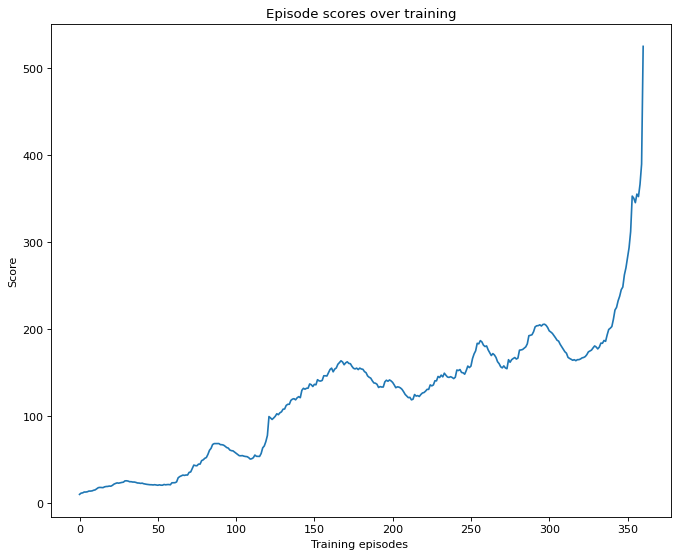

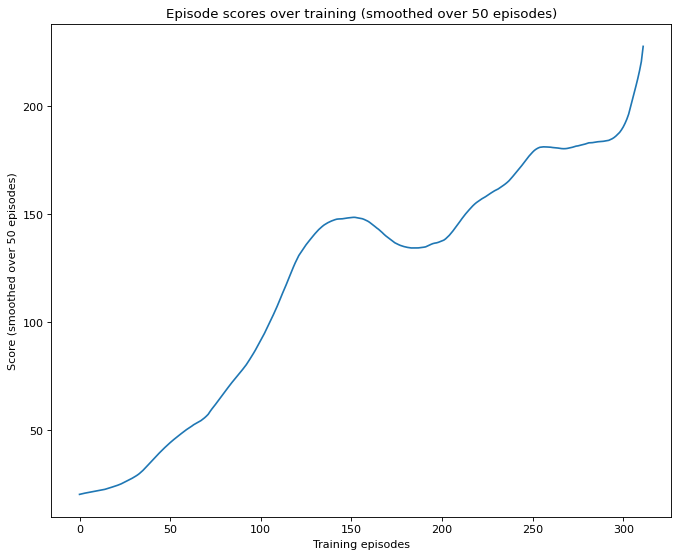

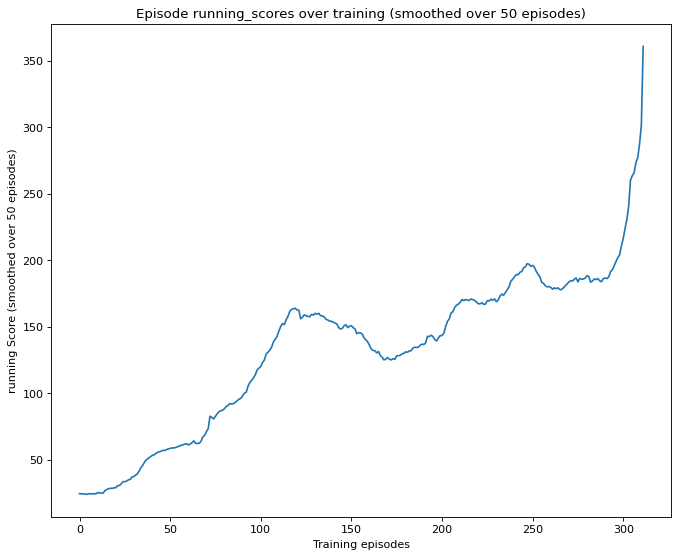

In [ ]:
folder_path='/content/drive/MyDrive/Models/folder_path/' # to save plotted figures

import matplotlib.pyplot as plt

fig_rough=plt.figure(figsize=(10, 8), dpi= 80, facecolor='w', edgecolor='k')
plt.plot(scores)# check scores name
plt.title("Episode scores over training")
plt.xlabel("Training episodes ")
plt.ylabel("Score")


file_name= "fig_scores_2nd_example_Cartpole"
#save fig

plt.savefig(f"{folder_path}{file_name}.png")

# Smooth scores
N = 50
smooth_scores = np.convolve(scores, np.ones((N,))/N, mode='valid')
fig_smooth=plt.figure(figsize=(10, 8), dpi= 80, facecolor='w', edgecolor='k')
plt.plot(smooth_scores)
plt.title("Episode scores over training (smoothed over {} episodes)".format(N))
plt.xlabel("Training episodes")
plt.ylabel("Score (smoothed over {} episodes)".format(N))
plt.savefig(f"{folder_path}smooth_{file_name}.png")


file_name= "fig_Rscores_2nd_example_Cartpole"
#save fig

plt.savefig(f"{folder_path}{file_name}.png")

# Smooth running scores
N = 50
smooth_running_scores = np.convolve(running_scores, np.ones((N,))/N, mode='valid')
fig_smooth=plt.figure(figsize=(10, 8), dpi= 80, facecolor='w', edgecolor='k')
plt.plot(smooth_running_scores)
plt.title("Episode running_scores over training (smoothed over {} episodes)".format(N))
plt.xlabel("Training episodes")
plt.ylabel("running Score (smoothed over {} episodes)".format(N))
plt.savefig(f"{folder_path}smooth_{file_name}.png")
